# 03 FOXN1^tdTom QC

## Notebook setup

In [1]:
import warnings
warnings.filterwarnings('ignore')

import scanpy as sc
import scanpy.external as sce
import numpy as np
import pandas as pd
import warnings, scipy.sparse as sp, matplotlib, matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.pyplot import rc_context
from collections import Counter
import matplotlib.font_manager
import pyreadr
import rpy2
from rpy2.robjects.packages import importr
import rpy2.robjects as robjects
import magic
#import seaborn as sns
import palantir
import loompy
#from scipy.sparse import csgraph

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = 'Arial'
matplotlib.rc('font', size=14)

pd.set_option('display.max_rows', 200)

sc.set_figure_params(dpi=80, dpi_save=300, color_map='Spectral_r', vector_friendly=True, transparent=True)
sc.settings.verbosity = 0 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.20.2 scipy==1.5.3 pandas==1.4.4 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.11 pynndescent==0.5.7


In [2]:
# preset color palettes and color maps
user_defined_palette =  [ '#F6222E', '#16FF32', '#3283FE', '#FEAF16', '#BDCDFF', '#3B00FB', '#1CFFCE', '#C075A6', '#F8A19F', '#B5EFB5', '#FBE426', '#C4451C', 
                          '#2ED9FF', '#c1c119', '#8b0000', '#FE00FA', '#1CBE4F', '#1C8356', '#0e452b', '#AA0DFE', '#B5EFB5', '#325A9B', '#90AD1C']

user_defined_cmap_markers = LinearSegmentedColormap.from_list('mycmap', ["#E6E6FF", "#CCCCFF", "#B2B2FF", "#9999FF",  "#6666FF",   "#3333FF", "#0000FF"])
user_defined_cmap_degs = LinearSegmentedColormap.from_list('mycmap', ["#0000FF", "#3333FF", "#6666FF", "#9999FF", "#B2B2FF", "#CCCCFF", "#E6E6FF", "#E6FFE6", "#CCFFCC", "#B2FFB2", "#99FF99", "#66FF66", "#33FF33", "#00FF00"])

In [3]:
%matplotlib inline 

## Load cellranger output files

In [4]:
from pathlib import Path

Foxn1tdTom_list=[]
names_list=[]

tenexdir = '../data/external/10xGenomics/Chromium/Foxn1_tdTom/'
h5_path = Path(tenexdir).glob('**/**/**/**/filtered_feature_bc_matrix.h5')

for path in h5_path:
    tmp_Foxn1tdTom = sc.read_10x_h5(path)
    tmp_Foxn1tdTom.var_names_make_unique()
    tmp_Foxn1tdTom.shape # check the number of cells and genes in sample 1
    Foxn1tdTom_list.append(tmp_Foxn1tdTom)

In [5]:
Foxn1tdTom = sc.concat(
    Foxn1tdTom_list, # add more annFoxn1tdTom objects here separated by commas
    join='outer', 
    label = 'sample', 
    keys = ['mo20_CD45neg_Foxn1creTom_m', 'mo20_CD45neg_wt_m', 'mo20_CD45neg_Foxn1creTom_f'], # or use your sample_names list (as used above) here. 
    # Make sure the order of the batch categories matches that of the AnnData objects 
    index_unique = '@'
)

In [6]:
Foxn1tdTom.raw = Foxn1tdTom # keep a copy of the raw Foxn1tdTom 
np.random.seed(42) 
index_list = np.arange(Foxn1tdTom.shape[0]) # randomize the order of cells for plotting
np.random.shuffle(index_list)
Foxn1tdTom = Foxn1tdTom[index_list]

In [7]:
Foxn1tdTom.shape

(17677, 32293)

In [8]:
# metFoxn1tdTom
Foxn1tdTom.obs['stage'] = '20mo'
Foxn1tdTom.obs['day'] = 'd0'

In [9]:
Foxn1tdTom.uns['day_colors'] = ['#0080FF']

## Calculate quality control metrics and perform standard data clean-up

In [10]:
sc.pp.calculate_qc_metrics(Foxn1tdTom, inplace=True)
#store all unfiltered/unprocessed data prior to downstream analysis
Foxn1tdTom.obs['original_total_counts'] = Foxn1tdTom.obs['total_counts']
Foxn1tdTom.obs['log10_original_total_counts'] = np.log10(Foxn1tdTom.obs['original_total_counts'])

In [11]:
# mitochondrial genes
Foxn1tdTom.var['mt'] = Foxn1tdTom.var_names.str.startswith(('MT-', 'mt-')) 
# ribosomal genes
Foxn1tdTom.var['ribo'] = Foxn1tdTom.var_names.str.startswith(('RPS','RPL', 'Rps', 'Rpl'))
# hemoglobin genes.
Foxn1tdTom.var['hb'] = Foxn1tdTom.var_names.str.startswith(('^Hb', '^HB'))

# for each cell compute fraction of counts in mitochondrial genes and ribosomal genes vs. all genes 
Foxn1tdTom.obs['mito_frac'] = np.sum(Foxn1tdTom[:,Foxn1tdTom.var['mt']==True].X, axis=1) / np.sum(Foxn1tdTom.X, axis=1)
Foxn1tdTom.obs['ribo_frac'] = np.sum(Foxn1tdTom[:,Foxn1tdTom.var['ribo']==True].X, axis=1) / np.sum(Foxn1tdTom.X, axis=1)
Foxn1tdTom.obs['hb_frac'] = np.sum(Foxn1tdTom[:,Foxn1tdTom.var['hb']==True].X, axis=1) / np.sum(Foxn1tdTom.X, axis=1)

### Identify doublet cells

In [12]:
sc.external.pp.scrublet(Foxn1tdTom, threshold=0.165, random_state=42) # choose threshold manually

Detected doublet rate = 2.1%
Estimated detectable doublet fraction = 31.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.5%


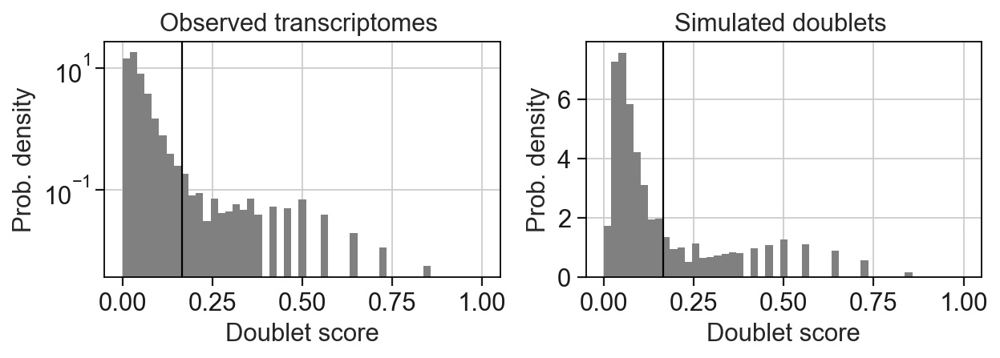

In [13]:
# check manual threshold
sc.external.pl.scrublet_score_distribution(Foxn1tdTom)

### Remove not expressed genes

In [14]:
# remove genes that are not expressed in any cells (remove columns with all 0s)
sc.pp.filter_genes(Foxn1tdTom, min_cells=1)

### Remove ribosomal protein genes

In [15]:
Foxn1tdTom = Foxn1tdTom[:,Foxn1tdTom.var['ribo']==False]
Foxn1tdTom.shape
Foxn1tdTom = Foxn1tdTom[:,Foxn1tdTom.var['hb']==False]
Foxn1tdTom.shape

(17677, 28064)

### Normalize for each cell's library size

In [16]:
sc.pp.normalize_per_cell(Foxn1tdTom, counts_per_cell_after=10**4)

### Log-transform counts

In [17]:
sc.pp.log1p(Foxn1tdTom)

## Select subset of principal components 

In [18]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1tdTom, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=False)

<function matplotlib.pyplot.show(close=None, block=None)>

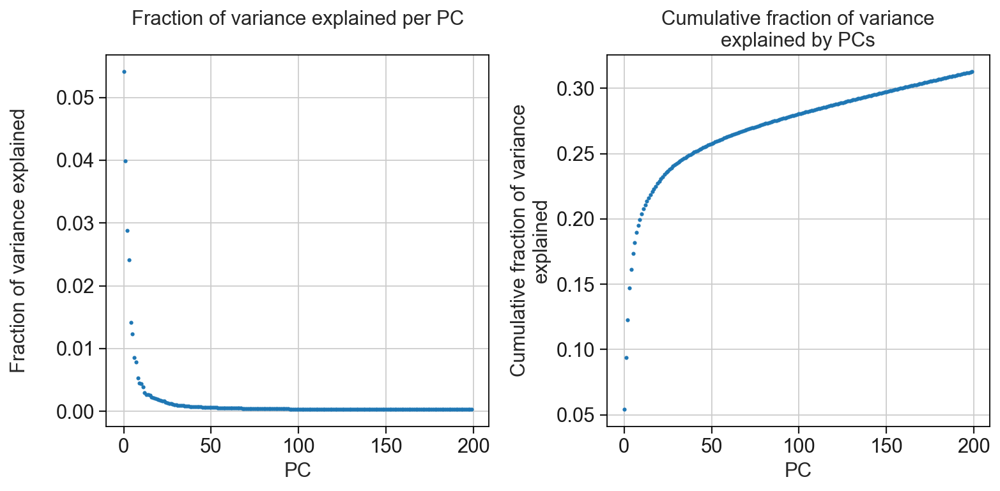

In [19]:
def observe_variance(anndata_object):
    fig = plt.figure(figsize=(10,5))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    # variance per principal component
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = anndata_object.uns['pca']['variance_ratio']
    ax1.scatter(x,y,s=4)
    ax1.set_xlabel('PC')
    ax1.set_ylabel('Fraction of variance explained\n')
    ax1.set_title('Fraction of variance explained per PC\n')
    # cumulative variance explained
    cml_var_explained = np.cumsum(anndata_object.uns['pca']['variance_ratio'])
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = cml_var_explained
    ax2.scatter(x,y,s=4)
    ax2.set_xlabel('PC')
    ax2.set_ylabel('Cumulative fraction of variance\nexplained')
    ax2.set_title('Cumulative fraction of variance\nexplained by PCs')
    fig.tight_layout()
    plot = plt.show
    return(plot)
observe_variance(Foxn1tdTom)

In [20]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1tdTom, n_comps=15,  svd_solver='arpack', random_state=rng, use_highly_variable=False)

In [21]:
sc.pp.neighbors(Foxn1tdTom, n_neighbors=15, random_state=42)

In [22]:
sc.tl.umap(Foxn1tdTom)

In [23]:
Foxn1tdTom.uns['sample_colors'] = user_defined_palette
Foxn1tdTom.uns['stage_colors'] =  ['#FF5A5F']

### Sample meta

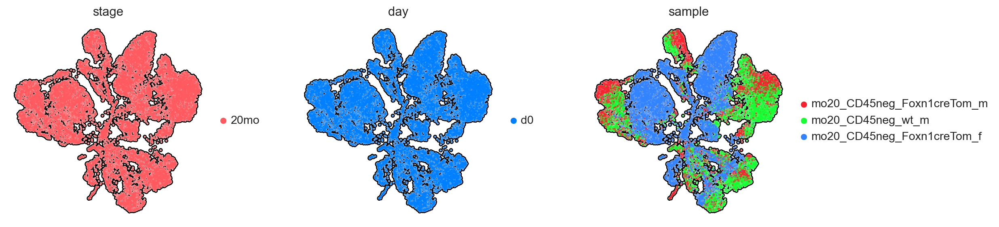

In [24]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['stage', 'day', 'sample'], 
    color_map='Spectral_r', 
    use_raw=False,
    ncols=15,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

### QC metrics

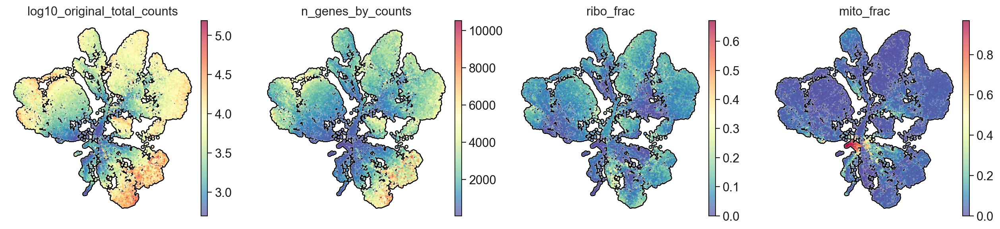

In [25]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['log10_original_total_counts', 'n_genes_by_counts','ribo_frac', 'mito_frac'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=5,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

### Potential contaminant populations

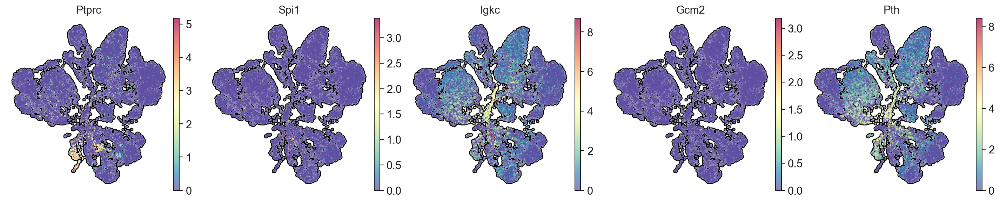

In [26]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['Ptprc', 'Spi1', 'Igkc', 'Gcm2', 'Pth'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

## Run unsupervised clustering analysis leiden

In [28]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(Foxn1tdTom, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

We can visualize the clustering to see which clusters match with the cells that we would like to filter out. Inspect the list of QC metrics and canonical markers to make your choice.

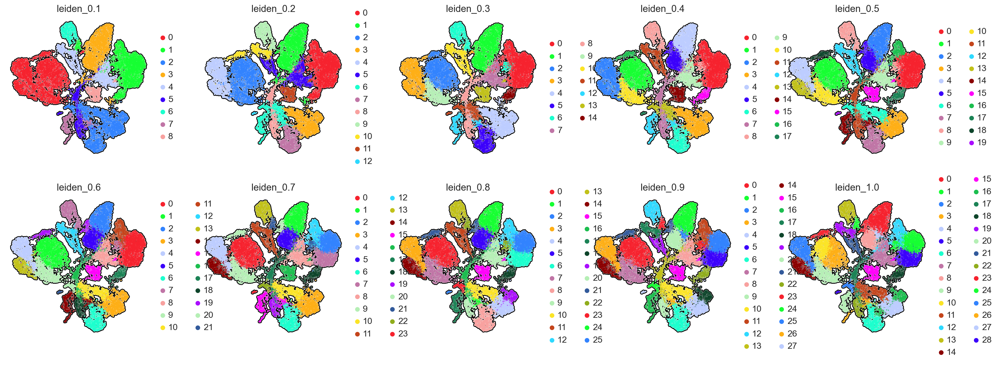

In [29]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

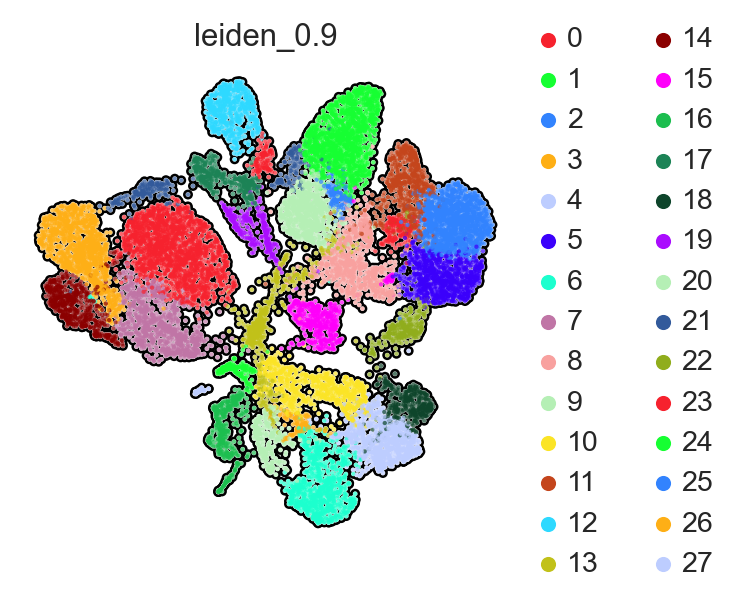

In [30]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['leiden_0.9'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    size=15,
    wspace = 0.7,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [31]:
Foxn1tdTom_total = Foxn1tdTom

## Filter out bad quality cells by cluster

Choose which clusters you want to remove, and add them to the list clusters_to_remove below.

In [32]:
clusters_to_remove = ['7', '10', '13', '16', '19', '20', '23', '24', '26', '27']

cluster_filter = [x not in clusters_to_remove for x in Foxn1tdTom.obs['leiden_0.9']]
print('Total number of cells pre-filtering: ' + str(Foxn1tdTom.shape[0]))
print('Number of cells to keep after filtering: ' + str(sum(cluster_filter)))
Foxn1tdTom_filtered = Foxn1tdTom[cluster_filter]

Total number of cells pre-filtering: 17677
Number of cells to keep after filtering: 13948


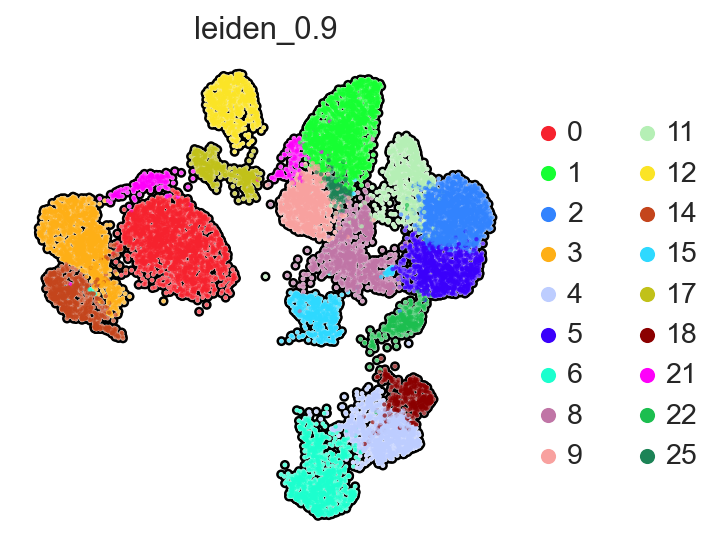

In [33]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom_filtered, 
    color=['leiden_0.9'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.5,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [34]:
Foxn1tdTom = Foxn1tdTom_filtered

In [35]:
Foxn1tdTom.shape

(13948, 28064)

## Filter out doublets and cell contaminants

This would be also a good spot to remove the doublets you have identified above or any other cell population that does not match your experimental strategy

In [36]:
Foxn1tdTom = Foxn1tdTom[Foxn1tdTom.obs['predicted_doublet'] == False]

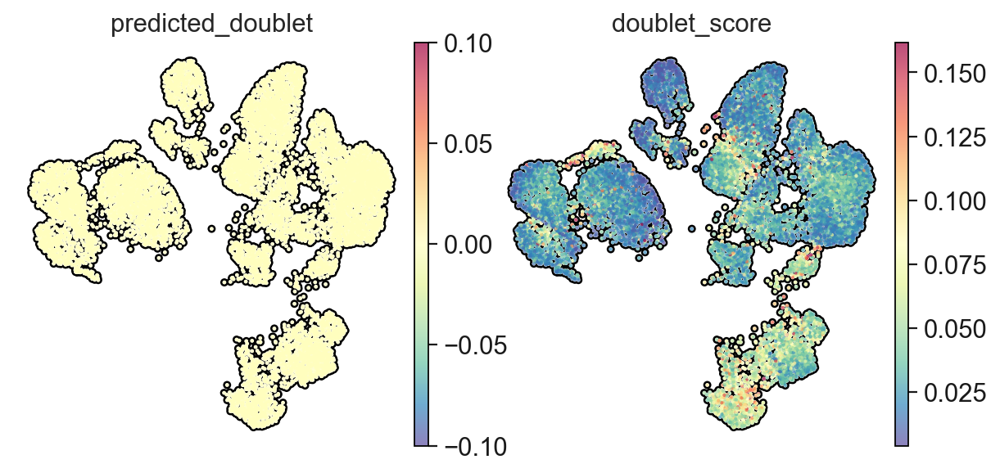

In [37]:
sc.pl.umap(
    Foxn1tdTom, 
    color=['predicted_doublet', 'doublet_score'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [38]:
Foxn1tdTom.obs['keep_cell'] = '0.yes'

In [39]:
keep_cells = pd.concat([Foxn1tdTom.obs['keep_cell']])

In [40]:
Foxn1tdTom_total.obs['keep_cell'] = '1.no'

In [41]:
Foxn1tdTom_total.obs['keep_cell'][Foxn1tdTom_total.obs.index.isin(keep_cells.index) == True] = '0.yes'

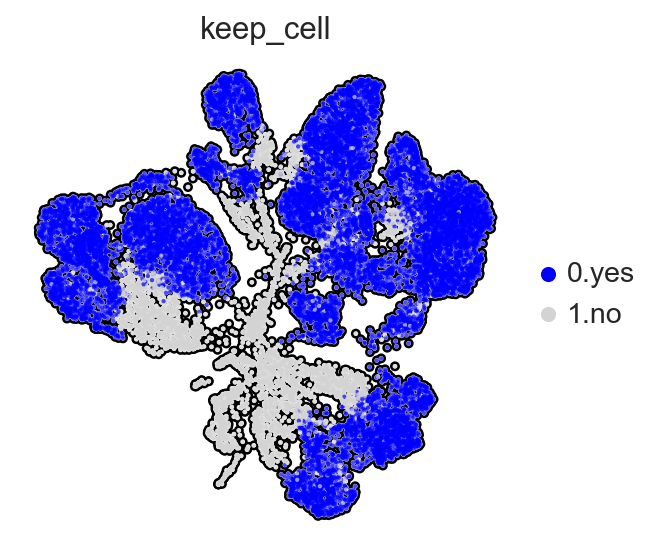

In [42]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    Foxn1tdTom_total, 
    color=['keep_cell'], 
    palette=['blue', '#d3d3d3'],  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [43]:
crosstb = pd.crosstab(Foxn1tdTom_total.obs['sample'], Foxn1tdTom_total.obs['keep_cell'])

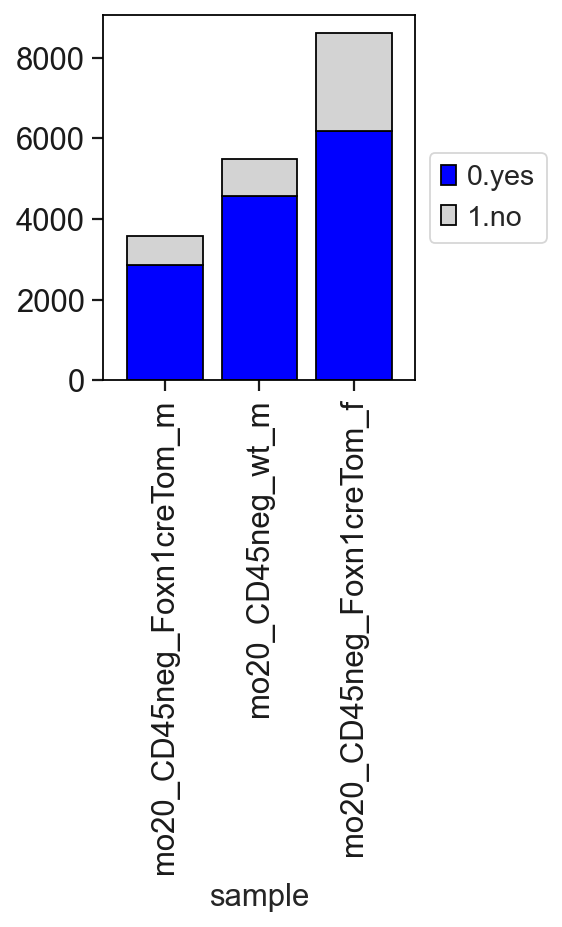

In [44]:
with rc_context({'figure.figsize': (2.5, 3)}):
    ax = crosstb.plot(kind="bar", stacked=True, edgecolor = "black", width=0.8,  color=['blue', '#d3d3d3'])
    ax.grid(False) 
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

Let's now inspect if the right number of doublet cells has been removed from the dataset.

In [45]:
Foxn1tdTom.shape

(13615, 28064)

## Reanalyze data after removal of cells

Once we have removed all unwanted cells, we need to reanalyze our data in a similar way to steps 4 and 5. 

In [46]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1tdTom, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=False)

<function matplotlib.pyplot.show(close=None, block=None)>

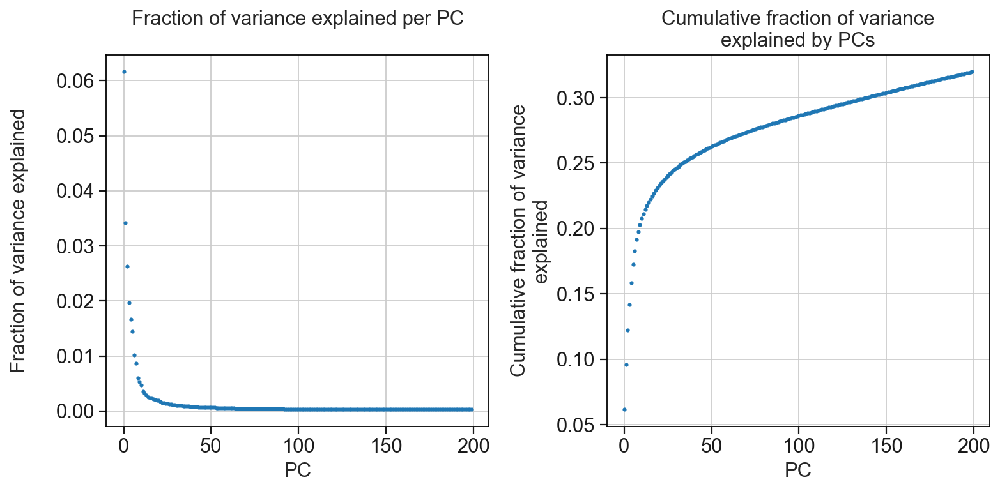

In [47]:
observe_variance(Foxn1tdTom)

🕹️ Remember to choose a different number of principal components based on the re-analysis

In [48]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1tdTom, n_comps=30, svd_solver='arpack', random_state=rng, use_highly_variable=False)

In [49]:
sc.pp.neighbors(Foxn1tdTom, n_neighbors=15)

In [50]:
sc.tl.umap(Foxn1tdTom)

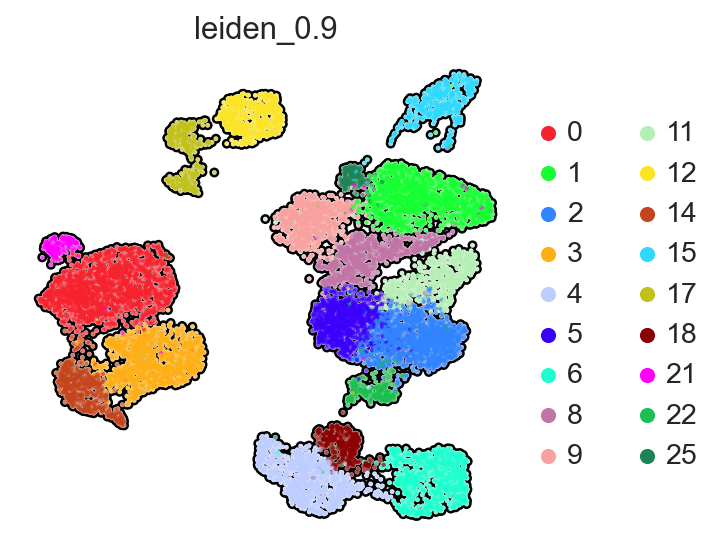

In [51]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['leiden_0.9'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

## Data for Fig 3e

In [54]:
sc.pp.highly_variable_genes(Foxn1tdTom, n_top_genes=3500, n_bins=20, flavor='seurat',  inplace=True)

In [55]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1tdTom, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

<function matplotlib.pyplot.show(close=None, block=None)>

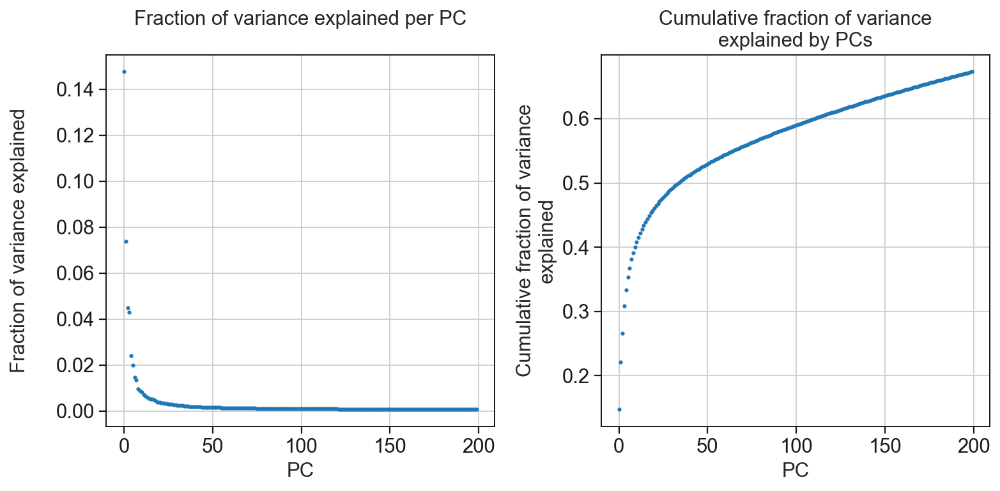

In [56]:
observe_variance(Foxn1tdTom)

In [57]:
rng = np.random.RandomState(42)
sc.tl.pca(Foxn1tdTom, n_comps=25, svd_solver='arpack', random_state=rng, use_highly_variable=True)

In [58]:
sce.pp.harmony_integrate(Foxn1tdTom, 'sample')

2024-04-16 11:05:59,114 - harmonypy - INFO - Iteration 1 of 10
2024-04-16 11:06:00,425 - harmonypy - INFO - Iteration 2 of 10
2024-04-16 11:06:01,735 - harmonypy - INFO - Iteration 3 of 10
2024-04-16 11:06:03,169 - harmonypy - INFO - Iteration 4 of 10
2024-04-16 11:06:04,562 - harmonypy - INFO - Iteration 5 of 10
2024-04-16 11:06:05,923 - harmonypy - INFO - Iteration 6 of 10
2024-04-16 11:06:07,282 - harmonypy - INFO - Converged after 6 iterations


In [59]:
sc.pp.neighbors(Foxn1tdTom, n_neighbors=15, use_rep='X_pca_harmony')
sc.tl.umap(Foxn1tdTom)

In [52]:
Foxn1tdTom.uns['sample_colors'] = user_defined_palette
Foxn1tdTom.uns['stage_colors'] =  ['#FF5A5F']

In [61]:
artEC_sign = ['Fbln5',	'Stmn2',	'Clu',	'Sema3g',	'Glul',	'Tm4sf1',	'Eps8l2',	'Col8a1',	'Nebl',	'Vegfc',	'Alpl',	'Arl15',	'Gja4',	'Edn1',	'S100a6',	'Mast4',	'Sox17',	'Pdgfd',	'Fbln2',	'Vim']
capEC_sign = ['Gpihbp1',	'Rgcc',	'Fabp4',	'Cd36',	'Car4',	'Mgll',	'Cd300lg',	'Tcf15',	'Kdr',	'Arhgap18',	'Igfbp7',	'Kank3',	'Aqp7',	'Etl4',	'Tspan13',	'Cavin2',	'Hspb1',	'Ppp1r2',	'Lims2',	'Fabp5']
venEC_sign = ['Lrg1',	'Il6st',	'Vwf',	'Plvap',	'mt-Co1',	'Selp',	'Spint2',	'Pcdh7',	'mt-Nd4',	'2200002D01Rik',	'Tmsb10',	'Eef1a1',	'mt-Co3',	'Bgn',	'Pde4d',	'mt-Atp6',	'Aqp1',	'Tpt1',	'Ctla2a',	'Ackr1']

In [62]:
x=19
sc.tl.score_genes(Foxn1tdTom, gene_list = artEC_sign[0:x],  score_name='artEC_sign', use_raw=False)
sc.tl.score_genes(Foxn1tdTom, gene_list = capEC_sign[0:x],  score_name='capEC_sign', use_raw=False)
sc.tl.score_genes(Foxn1tdTom, gene_list = venEC_sign[0:x],  score_name='venEC_sign', use_raw=False)

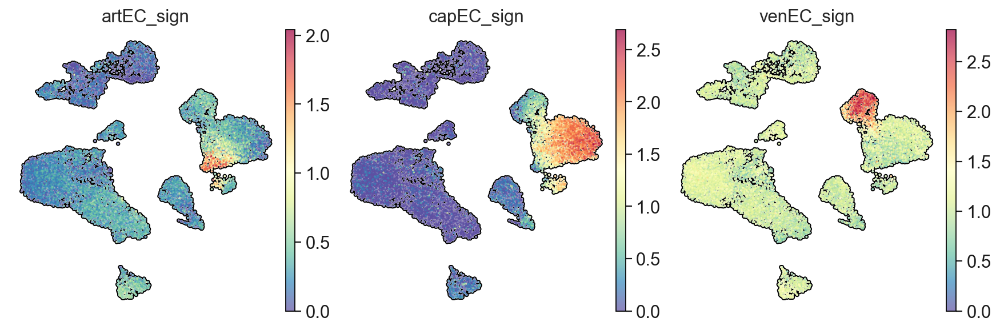

In [63]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    Foxn1tdTom,
    color=['artEC_sign', 'capEC_sign', 'venEC_sign'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    vmin=0    
)

In [64]:
capsFB_sign = ['Pi16',	'Timp2',	'Fn1',	'Opcml',	'Cd248',	'Mfap5',	'Anxa3',	'Pcolce2',	'Ackr3',	'Fndc1',	'Igfbp6',	'Sema3c',	'Clec3b',	'Creb5',	'Smpd3',	'Tmem100',	'Adgrd1',	'Ly6c1',	'Pcsk6',	'Nid1']
intFB_sign = ['Smoc2',	'Gpx3',	'Penk',	'Igf1',	'Gas1',	'Inmt',	'Pcolce',	'Lrp1',	'Itm2a',	'Gdf10',	'Rbp1',	'Fbln1',	'Sfrp1',	'Slit3',	'Svep1',	'Auts2',	'Lpl',	'Celf2',	'Serpinf1',	'Il11ra1']
medFB_sign = ['Csmd1',	'Serpine2',	'Enpp2',	'Ptn',	'Tmem176b',	'Tmem176a',	'B2m',	'Ccl19',	'Igfbp7',	'Apod',	'Bgn',	'H2-D1',	'Des',	'Ltc4s',	'Lhfp',	'Ifitm1',	'Cd9',	'Apoe',	'Lsamp',	'Ly6e']

In [65]:
x=19
sc.tl.score_genes(Foxn1tdTom, gene_list = capsFB_sign[0:x],  score_name='capsFB_sign', use_raw=False)
sc.tl.score_genes(Foxn1tdTom, gene_list = intFB_sign[0:x],  score_name='intFB_sign', use_raw=False)
sc.tl.score_genes(Foxn1tdTom, gene_list = medFB_sign[0:x],  score_name='medFB_sign', use_raw=False)

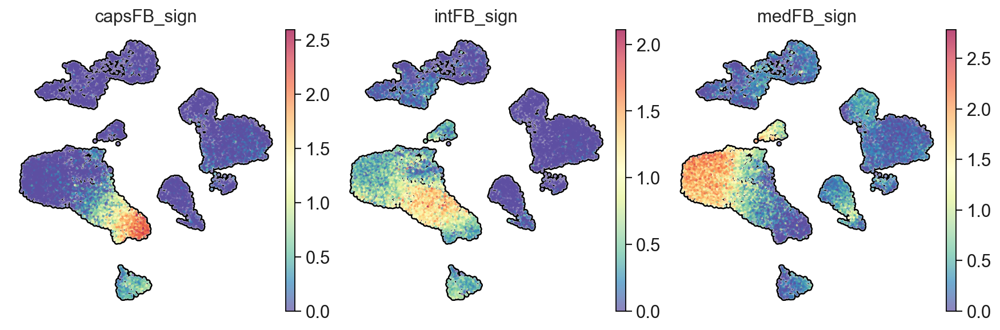

In [66]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    Foxn1tdTom,
    color=[ 'capsFB_sign', 'intFB_sign', 'medFB_sign'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False,
    vmin=0
)

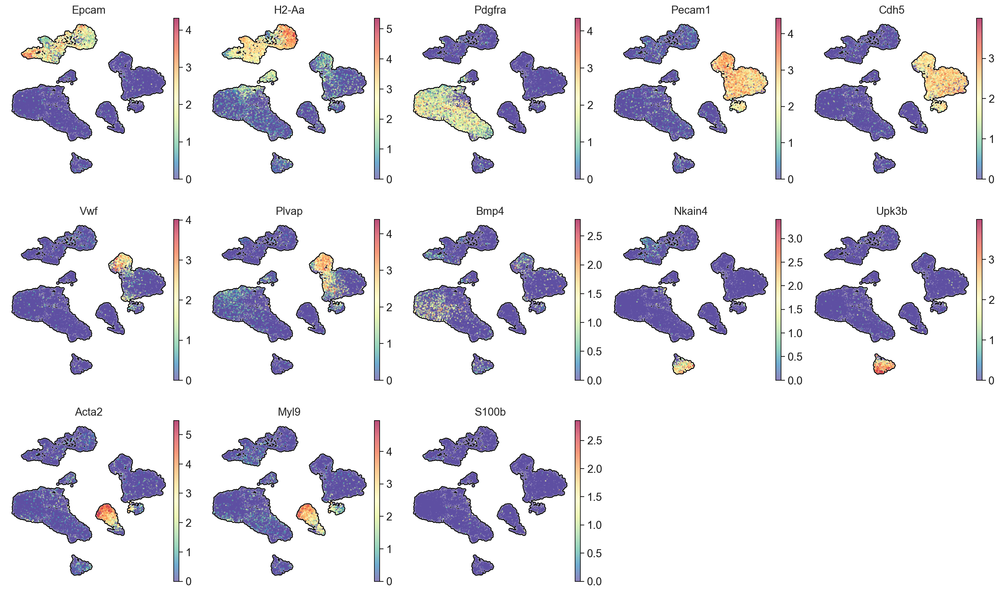

In [67]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['Epcam', 'H2-Aa', 'Pdgfra', 'Pecam1',  'Cdh5', 'Vwf', 'Plvap', 'Bmp4', 'Nkain4', 'Upk3b', 'Acta2', 'Myl9', 'S100b'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [68]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(Foxn1tdTom, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

We can visualize the clustering to see which clusters match with the cells that we would like to filter out. Inspect the list of QC metrics and canonical markers to make your choice.

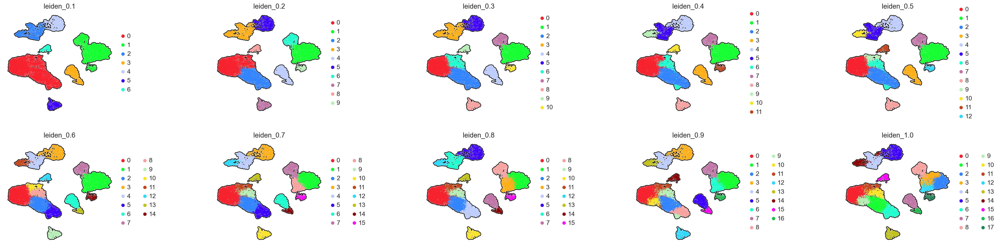

In [69]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8','leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.7,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

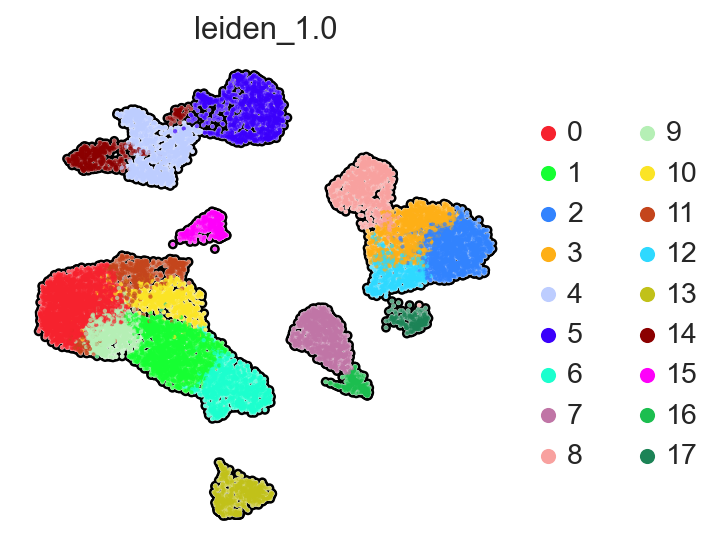

In [70]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    Foxn1tdTom, 
    color=['leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.7,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

### Create group annotation

In [71]:
Foxn1tdTom.obs['cell_type'] = ['FB' if (x=='0' or x=='1' or x=='6' or x=='9' or x=='10' or x=='11') else 
                          'EC' if (x=='2' or x=='3' or x=='8' or x=='12' or x=='17') else
                          'TEC' if (x=='4' or x=='5' or x=='14' or x=='15') else 
                          '6:MEC' if x=='13' else
                          '7:vSMC/PC' if (x=='7' or x=='16') else 'ERROR' for x in Foxn1tdTom.obs['leiden_1.0']] 

In [72]:
Foxn1tdTom.uns['cell_type_colors'] = ['#d62728','#19c9b3', '#ff7f0e','#199919', '#aa40fc']

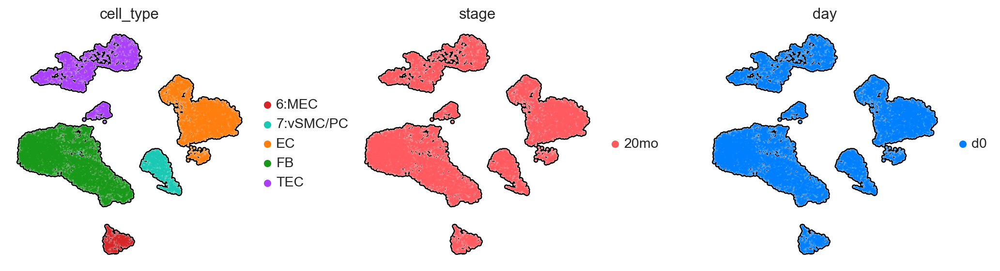

In [73]:
sc.pl.umap(Foxn1tdTom, color=['cell_type', 'stage', 'day'], 
                        color_map='Spectral_r',  use_raw=False, ncols=4, wspace = 0.3,
                        outline_width=[0.6, 0.05], size=15,  frameon=False, add_outline=True, sort_order = False)

In [75]:
Foxn1tdTom.obs['cell_type_subset'] = ['3:capsFB' if (x=='6') else '4:intFB' if (x=='1' or x=='10') else '5:medFB' if (x=='0' or x=='9' or x=='11')  else
                                 '0:arEC' if (x=='12') else  '1:capEC' if (x=='2' or x=='3' or x=='17') else  '2:venEC' if (x=='8') else
                                 'TEC' if (x=='4' or x=='5' or x=='14' or x=='15') else 
                                 '6:MEC' if x=='13' else
                                 '7:vSMC/PC' if (x=='7' or x=='16') else 'ERROR' for x in Foxn1tdTom.obs['leiden_1.0']] 

In [76]:
Foxn1tdTom.uns['cell_type_subset_colors'] = user_defined_palette

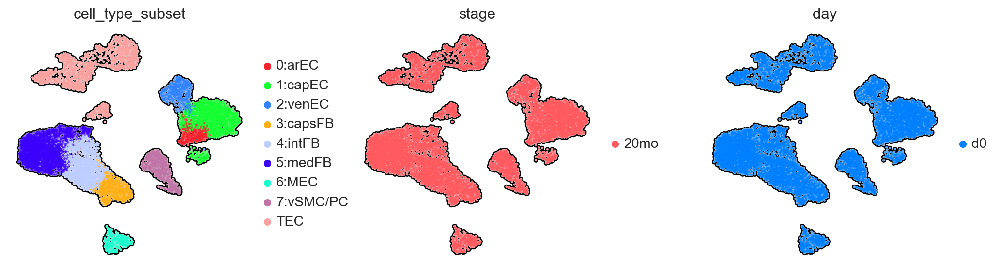

In [77]:
sc.pl.umap(Foxn1tdTom, color=['cell_type_subset', 'stage', 'day'], 
                        color_map='Spectral_r',  use_raw=False, ncols=4, wspace = 0.3,
                        outline_width=[0.6, 0.05], size=15,  frameon=False, add_outline=True, sort_order = False)

## Re-analyze TEC

In [78]:
TEC_Foxn1tdTom = Foxn1tdTom[(Foxn1tdTom.obs['cell_type']=='TEC')]

In [79]:
# Remove columns with all 0s
sc.pp.filter_genes(TEC_Foxn1tdTom, min_cells=1)

In [80]:
sc.pp.highly_variable_genes(TEC_Foxn1tdTom, n_top_genes=3500, flavor='seurat')

In [81]:
rng = np.random.RandomState(42)
sc.tl.pca(TEC_Foxn1tdTom, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

<function matplotlib.pyplot.show(close=None, block=None)>

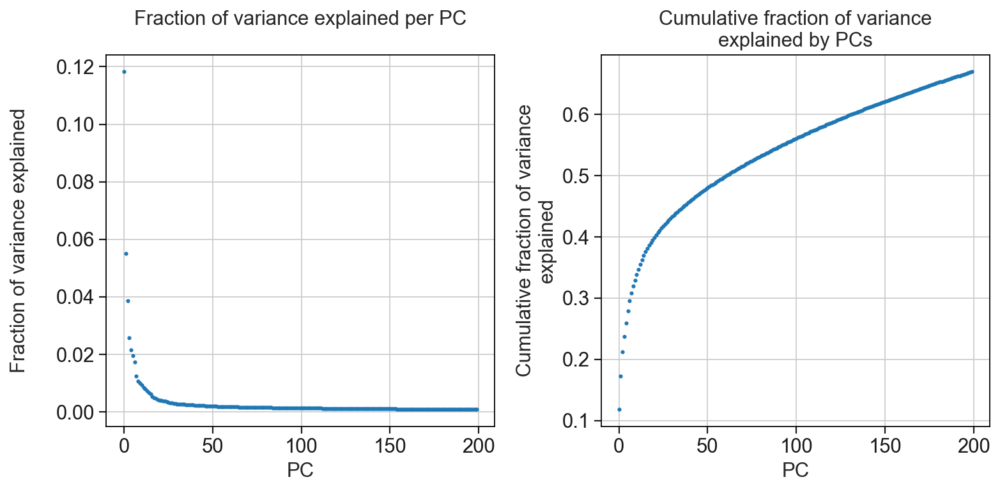

In [82]:
observe_variance(TEC_Foxn1tdTom)

In [83]:
rng = np.random.RandomState(42)
sc.tl.pca(TEC_Foxn1tdTom, n_comps=45, svd_solver='arpack', random_state=rng, use_highly_variable=True)

In [84]:
sce.pp.harmony_integrate(TEC_Foxn1tdTom, 'sample')

2024-04-16 11:11:01,549 - harmonypy - INFO - Iteration 1 of 10
2024-04-16 11:11:01,810 - harmonypy - INFO - Iteration 2 of 10
2024-04-16 11:11:02,059 - harmonypy - INFO - Iteration 3 of 10
2024-04-16 11:11:02,239 - harmonypy - INFO - Iteration 4 of 10
2024-04-16 11:11:02,357 - harmonypy - INFO - Iteration 5 of 10
2024-04-16 11:11:02,460 - harmonypy - INFO - Iteration 6 of 10
2024-04-16 11:11:02,607 - harmonypy - INFO - Iteration 7 of 10
2024-04-16 11:11:02,757 - harmonypy - INFO - Iteration 8 of 10
2024-04-16 11:11:02,840 - harmonypy - INFO - Iteration 9 of 10
2024-04-16 11:11:02,943 - harmonypy - INFO - Iteration 10 of 10
2024-04-16 11:11:03,049 - harmonypy - INFO - Stopped before convergence


In [85]:
sc.pp.neighbors(TEC_Foxn1tdTom, n_neighbors=15, use_rep='X_pca_harmony')
sc.tl.umap(TEC_Foxn1tdTom)

In [86]:
TEC_Foxn1tdTom.uns['sample_colors'] = user_defined_palette

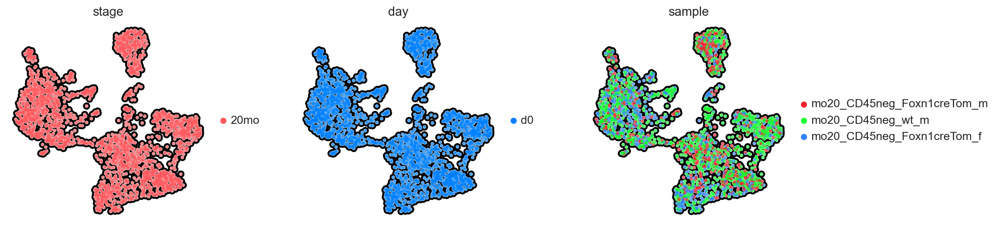

In [87]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    TEC_Foxn1tdTom, 
    color=['stage', 'day', 'sample'], 
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

### TEC signatures at steady state

In [88]:
aaTEC1_sign = ['Zbtb20',	'Cd81',	'Trpm3',	'Gstm1',	'Slc16a11',	'Btg1',	'BC006965',	'Cldn3',	'Gsta4',	'S100a11',	'Ly6e',	'Cdk19',	'Slc9a3r1',	'Ifi27l2a',	'Aldoc',	'Wfdc18',	'Phlda1',	'Fam107a',	'Gsn',	'Anxa2']
aaTEC2_sign = ['Csmd1',	'Zeb2',	'Mgp',	'Gsn',	'Zbtb20',	'Ndrg2',	'Serpine2',	'Cd81',	'Fxyd1',	'Laptm4a',	'Gpx3',	'Socs3',	'Igfbp7',	'Airn',	'Lgals1',	'Fos',	'Prrx1',	'Prkg1',	'Sparc',	'Junb']
cTEC_sign = ['Ctsl',	'Cstb',	'Cxcl12',	'Prss16',	'Krt18',	'Gas6',	'Pltp',	'Slc46a2',	'Ndufa11',	'Tbata',	'Ccl25',	'Psmb11',	'Tmem131l',	'Nlgn1',	'Prxl2b',	'Pax1',	'Wnt4',	'Dpp6',	'Psmb9',	'Bnip3l']
early_Pr = ['Apoe',	'Itm2b',	'Dcn',	'Gas6',	'Gas1',	'Rbms3',	'Laptm4a',	'Ctsl',	'Cpne8',	'Mir100hg',	'Gas5',	'Cst3',	'Ly6a',	'Ifitm3',	'Kazald1',	'Mir99ahg',	'Ifitm2',	'Plpp3',	'Oat',	'Auts2']
mTEC1_sign = ['Ccl21a',	'Krt14',	'Krt5',	'Ifitm3',	'Apoe',	'Tpm2',	'Cald1',	'Ifi27l2a',	'Ifitm2',	'Krt17',	'Nxn',	'Ctsl',	'Eya4',	'Rbms3',	'Perp',	'Ly6a',	'Igfbp4',	'Sult5a1',	'Map1lc3a',	'Ank3']
mTECprol_sign = ['H2afz',	'Stmn1',	'Ran',	'Eif5a',	'Hmgb2',	'Ube2s',	'Ybx1',	'Phgdh',	'Ptma',	'Selenoh',	'Ppia',	'Tubb5',	'Nme1',	'Pfn1',	'Ranbp1',	'Hmgn2',	'Hnrnpa1',	'Rbm3',	'Cks1b',	'Banf1']
mTEC2_sign = ['Srgn',	'Ubd',	'Cd52',	'Cyba',	'Cd74',	'H2-Aa',	'Syt1',	'Csn2',	'H2-Eb1',	'S100a14',	'H2-Oa',	'H2-Eb2',	'Hdc',	'Mrpl38',	'Nfkbia',	'Gm48239',	'Aire',	'Nup85',	'Hagh',	'Calcb']
basal_sign = ['Ly6d',	'Dmkn',	'Spink5',	'Fxyd3',	'Skint3',	'Dapl1',	'Hspb1',	'Sfn',	'Tacstd2',	'Pdzk1ip1',	'Prdx5',	'Oit1',	'Cdkn2a',	'Perp',	'Cdkn1a',	'Cdkn2b',	'Gsta4',	'Atox1',	'Lypd3',	'Cst6']
tuft_sign = ['Mctp1',	'Gng13',	'Avil',	'Rgs13',	'Espn',	'Lrmp',	'Anxa4',	'Ltc4s',	'Ptpn18',	'Bmx',	'Cystm1',	'Ivns1abp',	'Fyb',	'Ly6g6f',	'Calm2',	'Ethe1',	'Reep5',	'Lima1',	'1810046K07Rik',	'Abhd2']
nTEC_sign = ['Ptprn2',	'Cacna2d1',	'Car8',	'Scg5',	'Stxbp5l',	'Snap25',	'Chga',	'Cd9',	'Dnajc12',	'Ccser1',	'Pam',	'Camk2n1',	'Syt7',	'Cacna1a',	'Syt1',	'Cacnb2',	'Cystm1',	'Fam183b',	'Cplx2',	'Ceacam10']
goblet_sign = ['Wfdc2',	'Cyp2f2',	'Cxcl17',	'Gsto1',	'S100a11',	'Nupr1',	'Sorbs2',	'Anxa3',	'H2-K1',	'Krt19',	'Fxyd3',	'Ly6d',	'Ly6e',	'Serpinb11',	'Slc12a2',	'Anxa1',	'Ly6a',	'Bace2',	'Aqp5',	'Atp1b1']
Mlike_sign  = ['Ccl20',	'Ccl9',	'Serpinb6a',	'Serpinb1a',	'Tmsb4x',	'2200002D01Rik',	'Nostrin',	'Ctsh',	'Ccl6',	'AW112010',	'Spib',	'Bcl2a1d',	'Csn2',	'Cyp2a5',	'Fabp1',	'Hamp',	'Pold1',	'Bcl2a1b',	'Atox1',	'Iscu']

In [89]:
x=19
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = aaTEC1_sign[0:x],  score_name='aaTEC1_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = aaTEC2_sign[0:x],  score_name='aaTEC2_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = cTEC_sign[0:x],  score_name='cTEC_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = early_Pr[0:x],  score_name='early_Pr', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = mTEC1_sign[0:x],  score_name='mTEC1_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = mTECprol_sign[0:x],  score_name='mTECprol_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = mTEC2_sign[0:x],  score_name='mTEC2_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = basal_sign[0:x],  score_name='basal_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = tuft_sign[0:x],  score_name='tuft_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = nTEC_sign[0:x],  score_name='nTEC_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = goblet_sign[0:x],  score_name='goblet_sign', use_raw=False)
sc.tl.score_genes(TEC_Foxn1tdTom, gene_list = Mlike_sign[0:x],  score_name='Mlike_sign', use_raw=False)

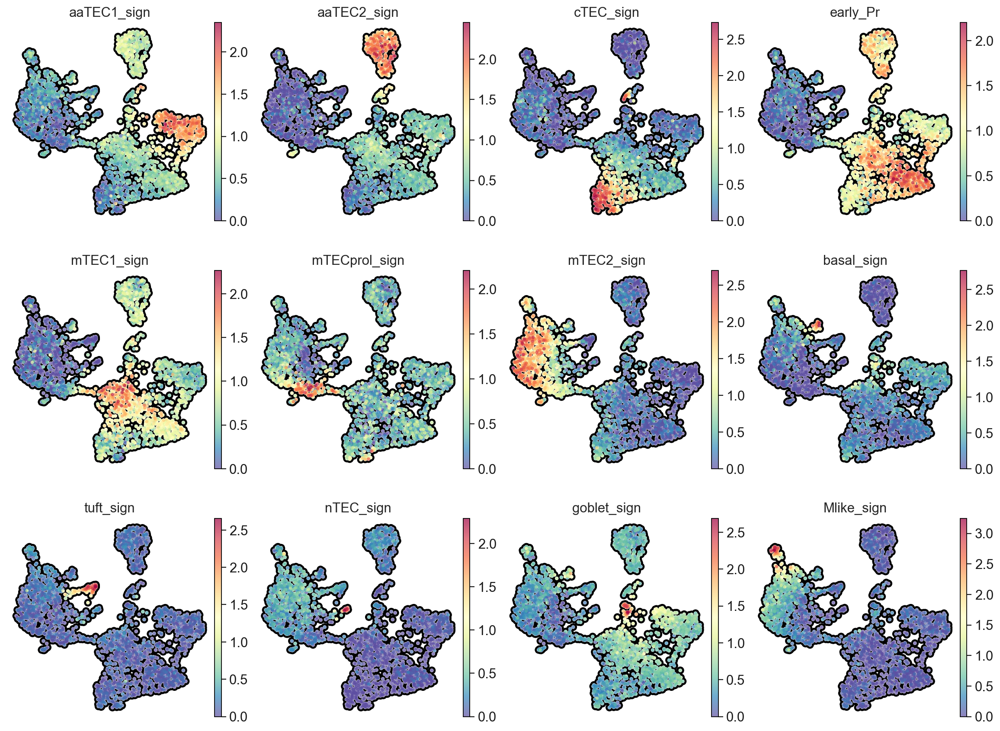

In [90]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_Foxn1tdTom,
    color=['aaTEC1_sign', 'aaTEC2_sign', 'cTEC_sign', 'early_Pr', 'mTEC1_sign', 'mTECprol_sign', 'mTEC2_sign', 
          'basal_sign', 'tuft_sign', 'nTEC_sign', 'goblet_sign','Mlike_sign'],
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=4,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
  #  sort_order = False,
    vmin=0
)

### TEC clustering and annotation

In [91]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(TEC_Foxn1tdTom, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

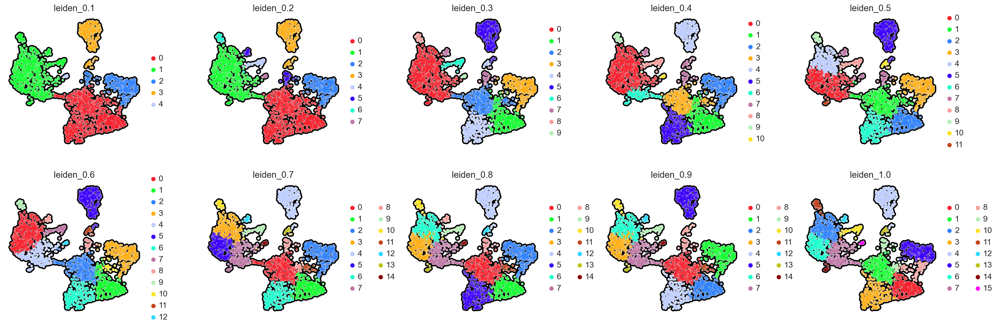

In [92]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    TEC_Foxn1tdTom, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8','leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

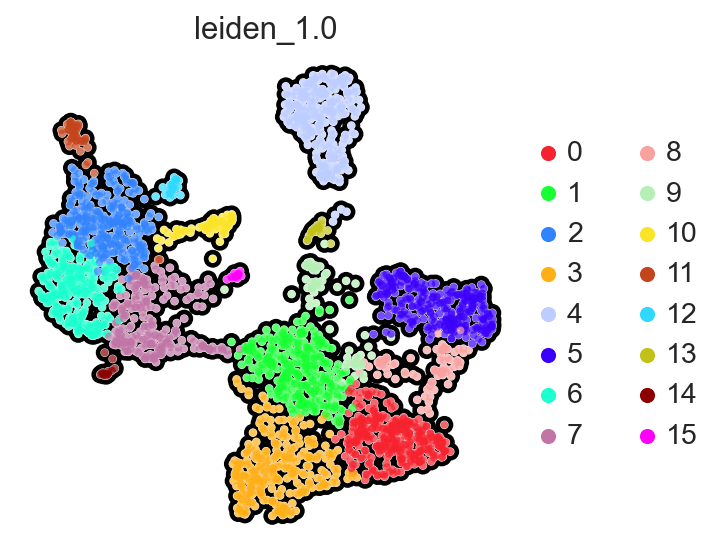

In [93]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    TEC_Foxn1tdTom, 
    color=['leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [94]:
TEC_Foxn1tdTom.obs['cell_type_subset'] = ['11:aaTEC2' if (x=='4' or x=='13') else '10:aaTEC1' if (x=='5' or x=='8') else '12:early Pr' if x=='0' else
                                    '12:cTEC' if (x=='3') else '13:mTEC1' if (x=='1') else 
                                    '14:mTEC-prol' if (x=='7')  else '15:mTEC2' if (x=='2' or x=='6' or x=='14') else
                                    '16:mimetic(basal)' if (x=='12') else '17:mimetic(tuft)' if (x=='10') else '18:mimetic(neuroendo)' if x=='15' else
                                    '19:mimetic(goblet)' if x=='9' else '20:mimetic(microfold)' if x=='11' else 'ERROR' for x in TEC_Foxn1tdTom.obs['leiden_1.0']] 

In [95]:
TEC_Foxn1tdTom.uns['cell_type_subset_colors'] = ['#2ED9FF', '#c1c119',  '#8b0000','#3B00FB', '#FE00FA', "#F8A19F", '#1CBE4F','#B5EFB5', '#BEFFF7' ,'#FEAF16', '#325A9B', '#C075A6', 'black', 'grey']

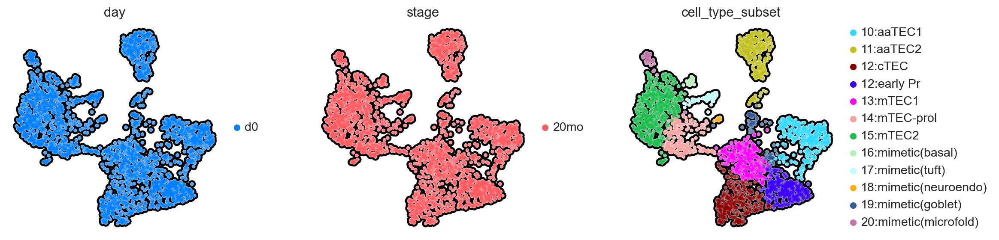

In [96]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    TEC_Foxn1tdTom, 
    color=['day', 'stage', 'cell_type_subset'], 
    ncols=6,   
    outline_width=[0.6, 0.05],
    frameon=False,
    cmap='Spectral_r',
    wspace = 0.3,
    add_outline=True
)

## Transfer annotation

In [99]:
annotated_subsets = pd.concat([TEC_Foxn1tdTom.obs['cell_type_subset'], Foxn1tdTom[(Foxn1tdTom.obs['cell_type_subset']!='TEC')].obs['cell_type_subset']])

In [100]:
Foxn1tdTom.obs['cell_type_subset']=''

In [101]:
Foxn1tdTom.obs['cell_type_subset'][Foxn1tdTom.obs.index.isin(annotated_subsets.index) == True] = annotated_subsets

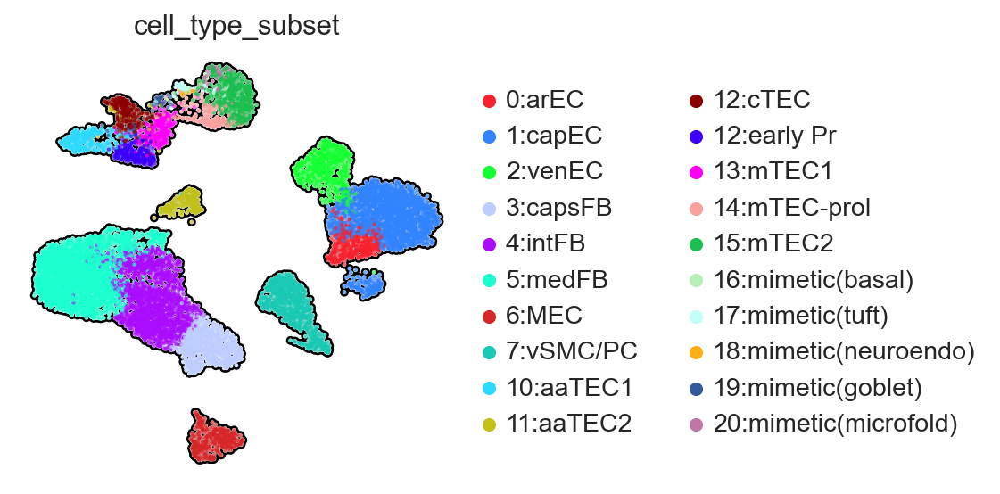

In [102]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

subset_palette =   ['#F6222E', '#3283FE', '#16FF32',  '#BDCDFF', '#AA0DFE','#1CFFCE', '#d62728', '#19c9b3', '#2ED9FF', '#c1c119', '#8b0000', '#3B00FB', '#FE00FA', "#F8A19F", '#1CBE4F','#B5EFB5', '#BEFFF7','#FEAF16', '#325A9B', '#C075A6']

sc.pl.umap(Foxn1tdTom, color=['cell_type_subset'], 
                     color_map='Spectral_r',
                     palette=subset_palette,
                     use_raw=False, 
                     ncols=4, 
                     wspace = 0.3,
                     outline_width=[0.6, 0.05], 
                     size=15,  
                     frameon=False,
                     add_outline=True, 
                     sort_order = False)

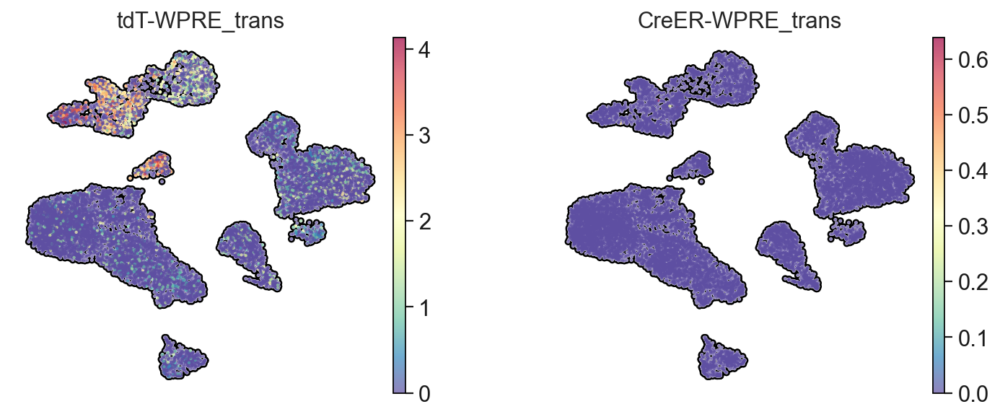

In [103]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(Foxn1tdTom, color=['tdT-WPRE_trans', 'CreER-WPRE_trans'], 
                     color_map='Spectral_r',
                     use_raw=False, 
                     ncols=4, 
                     wspace = 0.3,
                     outline_width=[0.6, 0.05], 
                     size=15,  
                     frameon=False, 
                     add_outline=True, 
                     sort_order = False
          )

In [ ]:
path_to_h5ad = '../output/anndata_io/Foxn1tdTom.h5ad'

In [ ]:
Foxn1tdTom.write(path_to_h5ad)

In [ ]:
Foxn1tdTom = sc.read_h5ad(path_to_h5ad)
Foxn1tdTom.uns['log1p']["base"] = None